In [3]:
!nvidia-smi
!pip install torch torchvision torchaudio GPUtil numba



/usr/bin/sh: 1: nvidia-smi: not found

[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [4]:
import torch
from GPUtil import showUtilization as gpu_usage
from numba import cuda
import os

# Set environment variable for CUDA driver if necessary (Linux example)
os.environ['NUMBA_CUDA_DRIVER'] = '/usr/lib/x86_64-linux-gnu/libcuda.so'

def free_gpu_cache():
    print("Initial GPU Usage")
    gpu_usage()                             

    torch.cuda.empty_cache()  # Clears the PyTorch cache

    # Reset CUDA device and close for Numba
    cuda.select_device(0)
    cuda.close()
    cuda.select_device(0)

    print("GPU Usage after emptying the cache")
    gpu_usage()

free_gpu_cache()


Initial GPU Usage
| ID | GPU | MEM |
------------------


CudaSupportError: Error at driver init: 

CUDA driver library cannot be found.
If you are sure that a CUDA driver is installed,
try setting environment variable NUMBA_CUDA_DRIVER
with the file path of the CUDA driver shared library.
:

In [5]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [6]:
import os
import numpy as np
from PIL import Image
import cv2

# Define the paths for SAR and optical images from the "urban" section
image_path_sar = '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/urban/s1'
image_path_sar1 = '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/agri/s1'
image_path_sar2 = '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/grassland/s1'
image_path_sar3= '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/barrenland/s1'

import os
import shutil

# Define the paths for SAR images from different classes
paths = {
    "urban": '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/urban/s1',
    "agri": '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/agri/s1',
    "grassland": '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/grassland/s1',
    "barrenland": '/kaggle/input/sentinel12-image-pairs-segregated-by-terrain/v_2/barrenland/s1'
}

# Create a new folder to store the combined dataset
combined_dataset_path = '/kaggle/working/SAR_Segment'
if not os.path.exists(combined_dataset_path):
    os.makedirs(combined_dataset_path)

# Create subdirectories for each class
for label in paths.keys():
    class_path = os.path.join(combined_dataset_path, label)
    if not os.path.exists(class_path):
        os.makedirs(class_path)

# Copy the images to the respective folders in the combined dataset
for label, image_path in paths.items():
    for image_name in os.listdir(image_path):
        src = os.path.join(image_path, image_name)
        dst = os.path.join(combined_dataset_path, label, image_name)
        shutil.copy(src, dst)

print("Dataset successfully combined into SAR_Segment with 4 classes.")




Dataset successfully combined into SAR_Segment with 4 classes.


In [7]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define image size and batch size
IMG_SIZE = (224, 224)  # You can adjust this size based on your needs
BATCH_SIZE = 32

# Set the path to the combined dataset
dataset_path = '/kaggle/working/SAR_Segment'

# Use ImageDataGenerator to load images from directories
datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)  # Rescale the pixel values between 0 and 1

# Create training and validation datasets
train_data = datagen.flow_from_directory(
    dataset_path,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',  # Since we have multiple classes
    subset='training'  # Use the training data split
)

val_data = datagen.flow_from_directory(
    dataset_path,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',  # Since we have multiple classes
    subset='validation'  # Use the validation data split
)

# Print class indices
print(train_data.class_indices)  # This will print the mapping of class names to indices


E0000 00:00:1728406051.614041      13 common_lib.cc:798] Could not set metric server port: INVALID_ARGUMENT: Could not find SliceBuilder port 8471 in any of the 0 ports provided in `tpu_process_addresses`="local"
=== Source Location Trace: ===
learning/45eac/tfrc/runtime/common_lib.cc:479
D1008 16:47:31.622358769      13 config.cc:196]                        gRPC EXPERIMENT call_status_override_on_cancellation   OFF (default:OFF)
D1008 16:47:31.622377276      13 config.cc:196]                        gRPC EXPERIMENT call_v3                                OFF (default:OFF)
D1008 16:47:31.622381132      13 config.cc:196]                        gRPC EXPERIMENT canary_client_privacy                  ON  (default:ON)
D1008 16:47:31.622383954      13 config.cc:196]                        gRPC EXPERIMENT capture_base_context                   ON  (default:ON)
D1008 16:47:31.622386720      13 config.cc:196]                        gRPC EXPERIMENT client_idleness                        ON  (defau

Found 12800 images belonging to 4 classes.
Found 3200 images belonging to 4 classes.
{'agri': 0, 'barrenland': 1, 'grassland': 2, 'urban': 3}


In [8]:
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define image size and batch size
IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# Load the dataset using ImageDataGenerator (without augmentation)
datagen = ImageDataGenerator(rescale=1./255)
dataset_path = '/kaggle/working/SAR_Segment'

data = datagen.flow_from_directory(
    dataset_path,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Get the images and labels as arrays
X, y = [], []
for i in range(len(data)):
    imgs, labels = data[i]
    X.extend(imgs)
    y.extend(labels)
    if i == (len(data) - 1):  # Stop once we've loaded the entire dataset
        break

# Convert lists to numpy arrays
X = np.array(X)
y = np.array(y)

# Flatten the images (required for Fuzzy C-Means)
X_flattened = X.reshape(len(X), -1)

# Split the data into training and testing sets (80/20 split)
X_train, X_test, y_train, y_test = train_test_split(X_flattened, y, test_size=0.2, random_state=42)


Found 16000 images belonging to 4 classes.


In [9]:
!pip install scikit-fuzzy


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.8/920.8 kB 12.8 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [11]:
! pip install tqdm



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [12]:
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm  # For progress bar

# Define image size and batch size
IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# Load the dataset using ImageDataGenerator (without augmentation)
datagen = ImageDataGenerator(rescale=1./255)
dataset_path = '/kaggle/working/SAR_Segment'

data = datagen.flow_from_directory(
    dataset_path,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Get the images and labels as arrays
X, y = [], []
for i in range(len(data)):
    imgs, labels = data[i]
    X.extend(imgs)
    y.extend(labels)
    if i == (len(data) - 1):  # Stop once we've loaded the entire dataset
        break

# Convert lists to numpy arrays
X = np.array(X)
y = np.array(y)

# 1. Sample 10% of the total dataset
sample_size = int(0.1 * len(X))  # 10% of the total number of images
indices = np.random.choice(len(X), sample_size, replace=False)  # Randomly select 10% of images
X_sample = X[indices]
y_sample = y[indices]

# 2. Flatten the images (required for Fuzzy C-Means)
X_sample_flattened = X_sample.reshape(len(X_sample), -1)

# 3. Split the sampled data into training and testing sets (80/20 split)
X_train, X_test, y_train, y_test = train_test_split(X_sample_flattened, y_sample, test_size=0.2, random_state=42)



Found 16000 images belonging to 4 classes.


In [13]:
# Function to apply FCM and return the performance
import skfuzzy as fuzz
from skfuzzy.cluster import cmeans, cmeans_predict
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

def apply_fcm(X_train, X_test, y_test, n_clusters, m, error, maxiter):
    # Apply Fuzzy C-Means clustering
    cntr, u, u0, d, jm, p, fpc = cmeans(X_train.T, c=n_clusters, m=m, error=error, maxiter=maxiter)

    # Predict the clusters for the test set
    u_test, _, _, _, _, _ = cmeans_predict(X_test.T, cntr, m=m, error=error, maxiter=maxiter)
    predicted_labels = np.argmax(u_test, axis=0)  # Cluster labels

    # Convert one-hot encoded y_test to class indices
    true_labels = np.argmax(y_test, axis=1)

    # Calculate accuracy as the performance metric
    accuracy = accuracy_score(true_labels, predicted_labels)

    return accuracy, classification_report(true_labels, predicted_labels), confusion_matrix(true_labels, predicted_labels)

# Define the parameter grid for the search
param_grid = {
    'n_clusters': [2, 3, 5],  # Vary the number of clusters
    'm': [1.5, 2.5],  # Vary the fuzziness coefficient
    'error': [0.005, 0.001],  # Error tolerance for convergence
    'maxiter': [500, 1000]  # Maximum number of iterations
}

# Calculate total iterations for progress bar
total_iterations = len(param_grid['n_clusters']) * len(param_grid['m']) * len(param_grid['error']) * len(param_grid['maxiter'])

# Variables to store the best results
best_accuracy = 0
best_params = None
best_classification_report = None
best_confusion_matrix = None

# Perform the grid search manually on the 10% subset with progress bar
with tqdm(total=total_iterations, desc="Grid Search Progress", ncols=100) as pbar:
    for n_clusters in param_grid['n_clusters']:
        for m in param_grid['m']:
            for error in param_grid['error']:
                for maxiter in param_grid['maxiter']:
                    # Update the progress bar at each iteration
                    pbar.set_postfix({"n_clusters": n_clusters, "m": m, "error": error, "maxiter": maxiter})
                    
                    # Apply FCM with the current set of parameters
                    accuracy, clf_report, conf_matrix = apply_fcm(X_train, X_test, y_test, n_clusters, m, error, maxiter)
                    
                    # Keep track of the best performance
                    if accuracy > best_accuracy:
                        best_accuracy = accuracy
                        best_params = (n_clusters, m, error, maxiter)
                        best_classification_report = clf_report
                        best_confusion_matrix = conf_matrix
                    
                    pbar.update(1)  # Update progress bar

# Output the best results
print(f"\nBest Accuracy: {best_accuracy}")
print(f"Best Parameters: n_clusters={best_params[0]}, m={best_params[1]}, error={best_params[2]}, maxiter={best_params[3]}")
print("\nBest Classification Report:\n", best_classification_report)
print("\nBest Confusion Matrix:\n", best_confusion_matrix)


Grid Search Progress:   0%|   | 0/24 [00:00<?, ?it/s, n_clusters=2, m=1.5, error=0.005, maxiter=500]/usr/local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, m


Best Accuracy: 0.315625
Best Parameters: n_clusters=3, m=1.5, error=0.001, maxiter=500

Best Classification Report:
               precision    recall  f1-score   support

           0       0.13      0.27      0.18        60
           1       0.53      0.57      0.55        95
           2       0.32      0.44      0.37        71
           3       0.00      0.00      0.00        94

    accuracy                           0.32       320
   macro avg       0.25      0.32      0.27       320
weighted avg       0.25      0.32      0.28       320


Best Confusion Matrix:
 [[16 14 30  0]
 [23 54 18  0]
 [11 29 31  0]
 [71  4 19  0]]


Found 16000 images belonging to 4 classes.


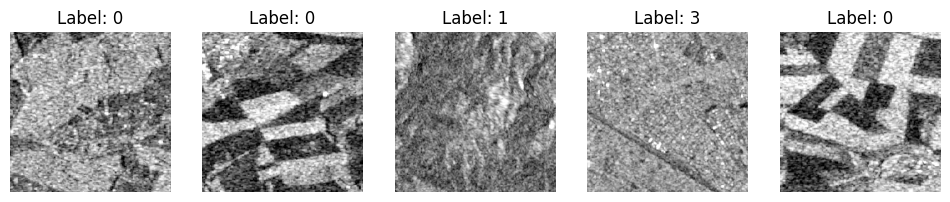

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm  # For progress bar

# Define image size and batch size
IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# Load the dataset using ImageDataGenerator (without augmentation)
datagen = ImageDataGenerator(rescale=1./255)
dataset_path = '/kaggle/working/SAR_Segment'

data = datagen.flow_from_directory(
    dataset_path,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Get the images and labels as arrays
X, y = [], []
for i in range(len(data)):
    imgs, labels = data[i]
    X.extend(imgs)
    y.extend(labels)
    if i == (len(data) - 1):  # Stop once we've loaded the entire dataset
        break

# Convert lists to numpy arrays
X = np.array(X)
y = np.array(y)

# 1. Sample 30% of the total dataset
sample_size = int(0.3 * len(X))  # 30% of the total number of images
indices = np.random.choice(len(X), sample_size, replace=False)  # Randomly select 10% of images
X_sample = X[indices]
y_sample = y[indices]

# 2. Flatten the images (required for Fuzzy C-Means)
X_sample_flattened = X_sample.reshape(len(X_sample), -1)

# 3. Display 5 sample images with their true labels
def display_sample_images(X_sample, y_sample):
    """Display 5 random images with their true labels."""
    # Randomly select 5 images to display
    indices = np.random.choice(len(X_sample), 5, replace=False)

    plt.figure(figsize=(12, 6))
    for i, idx in enumerate(indices):
        plt.subplot(1, 5, i + 1)
        plt.imshow(X_sample[idx])
        plt.title(f"Label: {np.argmax(y_sample[idx])}")  # Display the class index as label
        plt.axis('off')
    plt.show()

# Call the function to display the images
display_sample_images(X_sample, y_sample)


In [24]:
X_sample_flattened.shape


(4800, 150528)

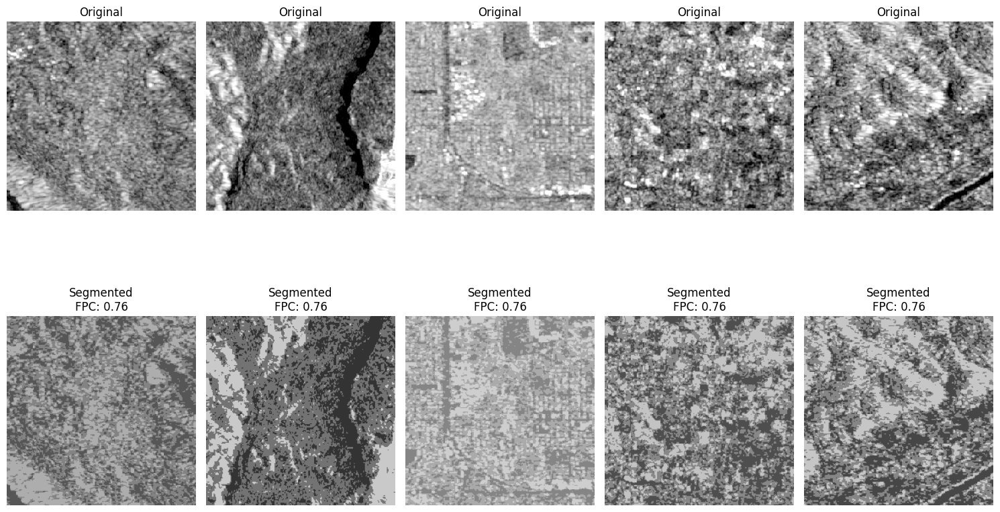

In [25]:
import skfuzzy as fuzz

def fuzzy_c_means_segmentation(image, num_clusters=3):
    """Apply Fuzzy C-Means segmentation to a single image."""
    # Reshape the image to a 2D array of pixels
    pixel_values = image.reshape(-1, 3).T  # Shape: (3, num_pixels)

    # Perform Fuzzy C-Means clustering
    cntr, u, _, _, _, _, _ = fuzz.cluster.cmeans(
        pixel_values,
        c=num_clusters,
        m=2,  # Fuzziness parameter
        error=0.005,
        maxiter=1000,
        init=None
    )

    # Assign each pixel to the cluster with highest membership value
    cluster_membership = np.argmax(u, axis=0)

    # Create segmented image
    segmented_image = np.zeros_like(pixel_values)
    for i in range(num_clusters):
        segmented_image[:, cluster_membership == i] = cntr[i][:, np.newaxis]

    return segmented_image.T.reshape(image.shape), u

def calculate_fuzzy_partition_coefficient(u):
    """Calculate the Fuzzy Partition Coefficient."""
    return np.sum(u ** 2) / u.shape[1]

# Segment and display images
def segment_and_display_images(X_sample):
    """Segment images and display both original and segmented versions."""
    num_clusters = 3
    fpc_values = []

    plt.figure(figsize=(15, 10))
    
    for i in range(5):  # Display 5 images
        original_image = X_sample[i]
        
        # Perform FCM segmentation
        segmented_image, u = fuzzy_c_means_segmentation(original_image, num_clusters)
        
        # Calculate FPC for this image
        fpc = calculate_fuzzy_partition_coefficient(u)
        fpc_values.append(fpc)

        # Display original and segmented images
        plt.subplot(2, 5, i + 1)
        plt.imshow(original_image)
        plt.title("Original")
        plt.axis('off')

        plt.subplot(2, 5, i + 6)
        plt.imshow(segmented_image)
        plt.title(f"Segmented\nFPC: {fpc:.2f}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Call the function to segment and display images
segment_and_display_images(X_sample)


Performing FCM for num_clusters=2 and fuzziness=1.5...


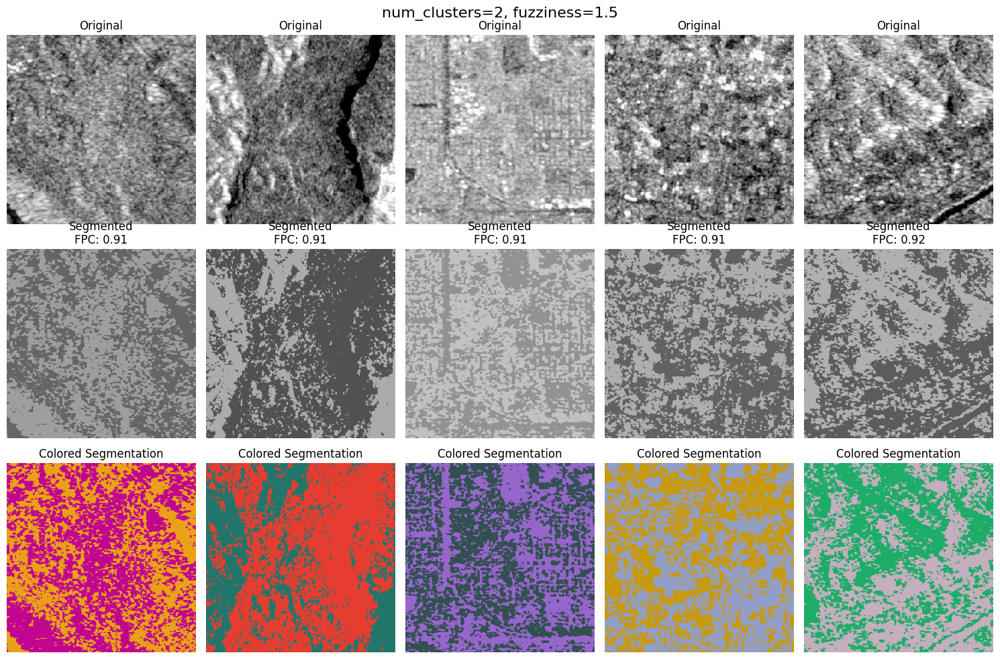


Performing FCM for num_clusters=2 and fuzziness=2...


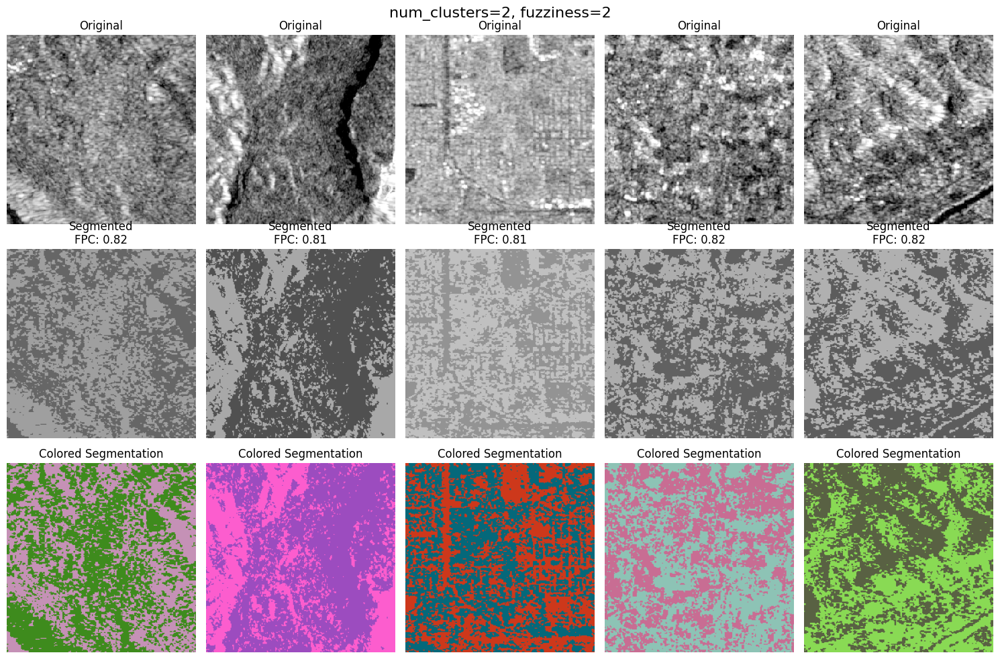


Performing FCM for num_clusters=3 and fuzziness=1.5...


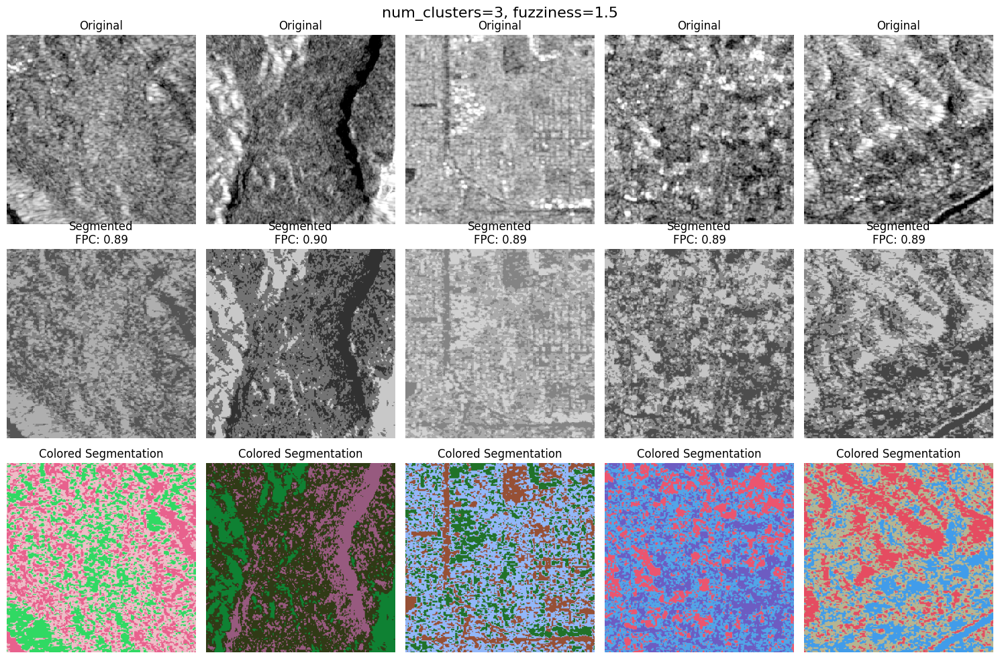


Performing FCM for num_clusters=3 and fuzziness=2...


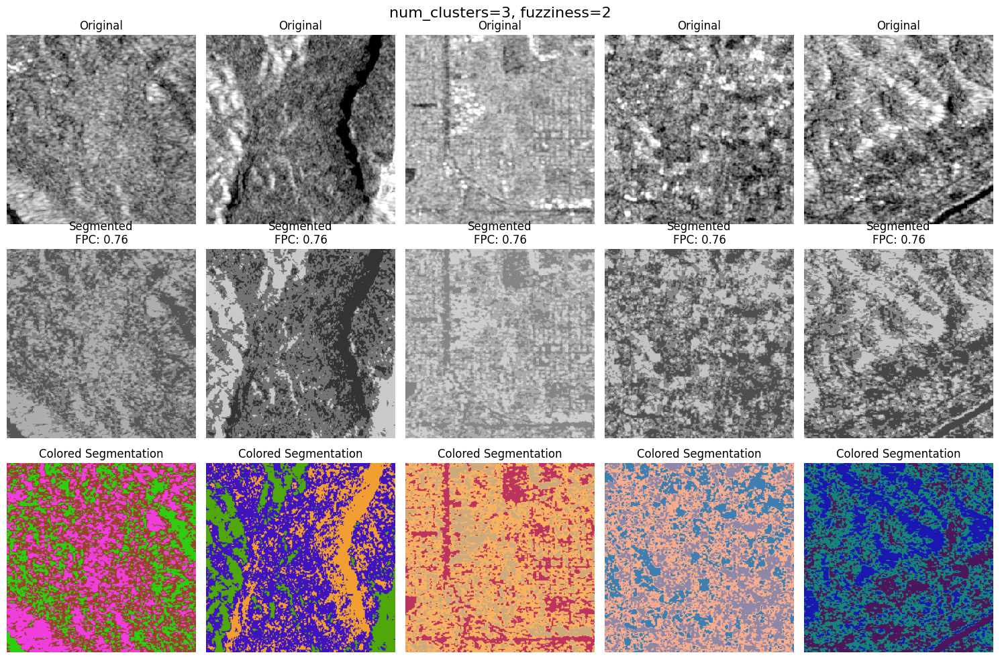


Performing FCM for num_clusters=4 and fuzziness=1.5...


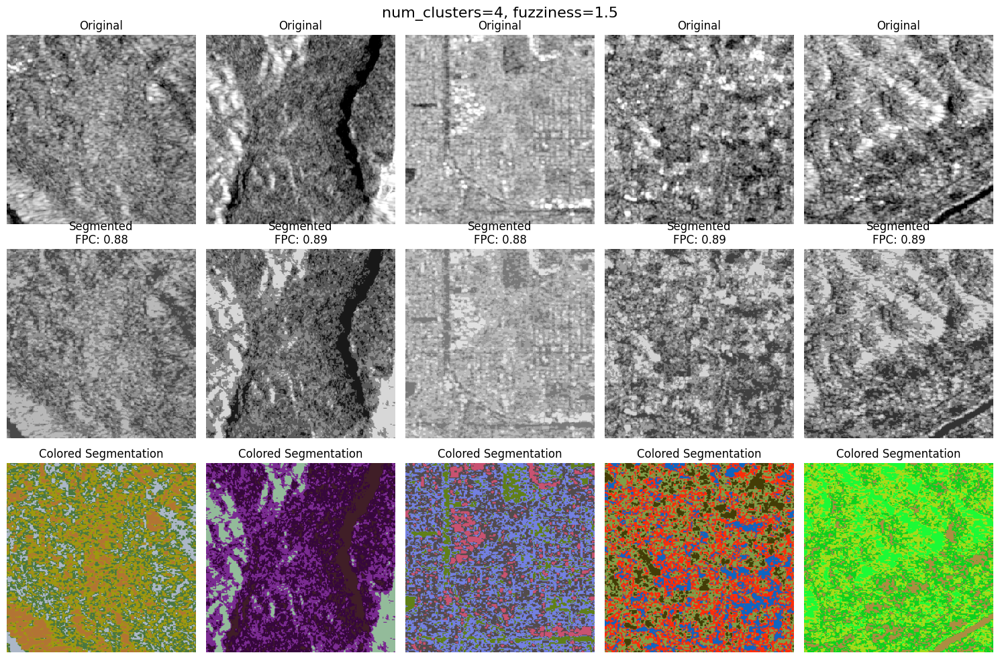


Performing FCM for num_clusters=4 and fuzziness=2...


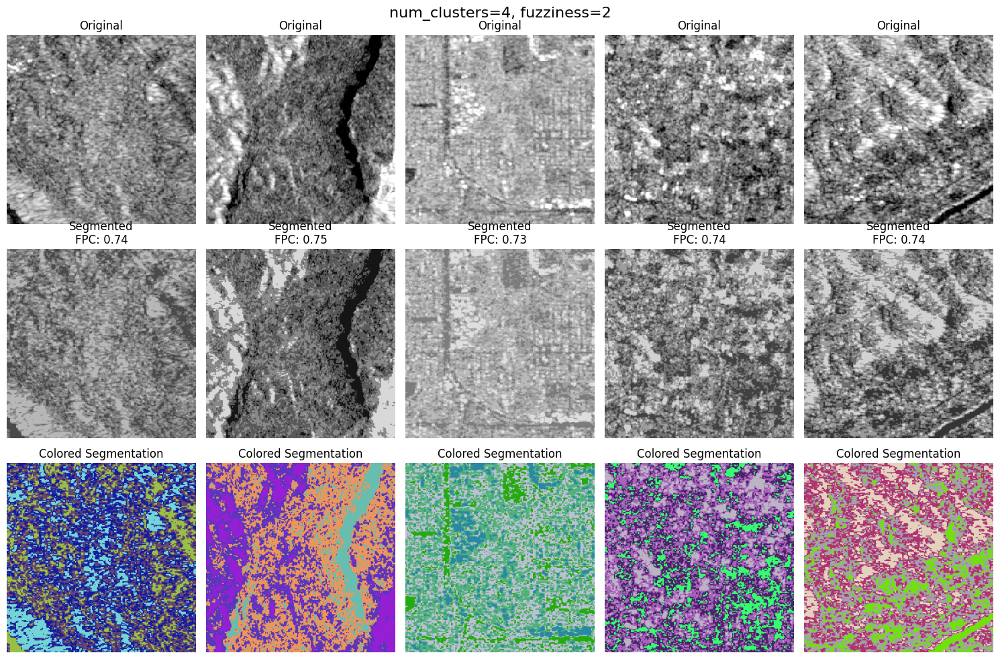


Fuzzy Partition Coefficient (FPC) Results:
num_clusters=2, fuzziness=1.5 -> FPC: 0.9110
num_clusters=2, fuzziness=2 -> FPC: 0.8129
num_clusters=3, fuzziness=1.5 -> FPC: 0.8926
num_clusters=3, fuzziness=2 -> FPC: 0.7618
num_clusters=4, fuzziness=1.5 -> FPC: 0.8862
num_clusters=4, fuzziness=2 -> FPC: 0.7386


In [34]:
import numpy as np
import matplotlib.pyplot as plt
import skfuzzy as fuzz
from itertools import product

# Function to generate color for each cluster
def get_colored_segmented_image(image_shape, cluster_membership, num_clusters):
    """Generate a colored image where each cluster is assigned a distinct color."""
    # Define colors for clusters
    colors = np.random.rand(num_clusters, 3)  # Random colors for each cluster

    # Create a blank color image
    colored_image = np.zeros((image_shape[0] * image_shape[1], 3))

    # Assign colors based on the cluster membership
    for cluster_idx in range(num_clusters):
        colored_image[cluster_membership == cluster_idx] = colors[cluster_idx]

    return colored_image.reshape(image_shape)

def fuzzy_c_means_segmentation(image, num_clusters, fuzziness):
    """Apply Fuzzy C-Means segmentation to a single image."""
    # Reshape the image to a 2D array of pixels
    pixel_values = image.reshape(-1, 3).T  # Shape: (3, num_pixels)

    # Perform Fuzzy C-Means clustering
    cntr, u, _, _, _, _, _ = fuzz.cluster.cmeans(
        pixel_values,
        c=num_clusters,
        m=fuzziness,  # Fuzziness parameter
        error=0.005,
        maxiter=1000,
        init=None
    )

    # Assign each pixel to the cluster with the highest membership value
    cluster_membership = np.argmax(u, axis=0)

    # Create segmented image (grayscale)
    segmented_image = np.zeros_like(pixel_values)
    for i in range(num_clusters):
        segmented_image[:, cluster_membership == i] = cntr[i][:, np.newaxis]

    return segmented_image.T.reshape(image.shape), get_colored_segmented_image(image.shape, cluster_membership, num_clusters), u

def calculate_fuzzy_partition_coefficient(u):
    """Calculate the Fuzzy Partition Coefficient (FPC)."""
    return np.sum(u ** 2) / u.shape[1]

# Segment and display images for grid search of num_clusters and fuzziness
def segment_and_display_images_grid_search(X_sample, num_clusters_list, fuzziness_list):
    """Segment images using different values of num_clusters and fuzziness, then display the results."""
    fpc_results = {}

    # Create combinations of num_clusters and fuzziness
    combinations = list(product(num_clusters_list, fuzziness_list))
    
    for num_clusters, fuzziness in combinations:
        print(f"\nPerforming FCM for num_clusters={num_clusters} and fuzziness={fuzziness}...")

        fpc_values = []
        plt.figure(figsize=(15, 10))

        # Perform segmentation on 5 random images
        for i in range(5):  # Display 5 images
            original_image = X_sample[i]

            # Perform FCM segmentation
            segmented_image, colored_image, u = fuzzy_c_means_segmentation(original_image, num_clusters, fuzziness)

            # Calculate FPC for this image
            fpc = calculate_fuzzy_partition_coefficient(u)
            fpc_values.append(fpc)

            # Display original, segmented grayscale, and colored segmented images
            plt.subplot(3, 5, i + 1)
            plt.imshow(original_image)
            plt.title("Original")
            plt.axis('off')

            plt.subplot(3, 5, i + 6)
            plt.imshow(segmented_image)
            plt.title(f"Segmented\nFPC: {fpc:.2f}")
            plt.axis('off')

            plt.subplot(3, 5, i + 11)
            plt.imshow(colored_image)
            plt.title(f"Colored Segmentation")
            plt.axis('off')

        plt.suptitle(f"num_clusters={num_clusters}, fuzziness={fuzziness}", fontsize=16)
        plt.tight_layout()
        plt.show()

        # Store FPC values for this combination
        fpc_results[(num_clusters, fuzziness)] = np.mean(fpc_values)
    
    return fpc_results

# Example usage:
num_clusters_list = [2, 3, 4]  # Define number of clusters to test
fuzziness_list = [1.5, 2]  # Define fuzziness parameters to test

# Call the function to perform grid search and display segmented images
fpc_results = segment_and_display_images_grid_search(X_sample, num_clusters_list, fuzziness_list)

# Output FPC results for each combination
print("\nFuzzy Partition Coefficient (FPC) Results:")
for (num_clusters, fuzziness), fpc in fpc_results.items():
    print(f"num_clusters={num_clusters}, fuzziness={fuzziness} -> FPC: {fpc:.4f}")



Performing FCM for num_clusters=2 and fuzziness=1.5...


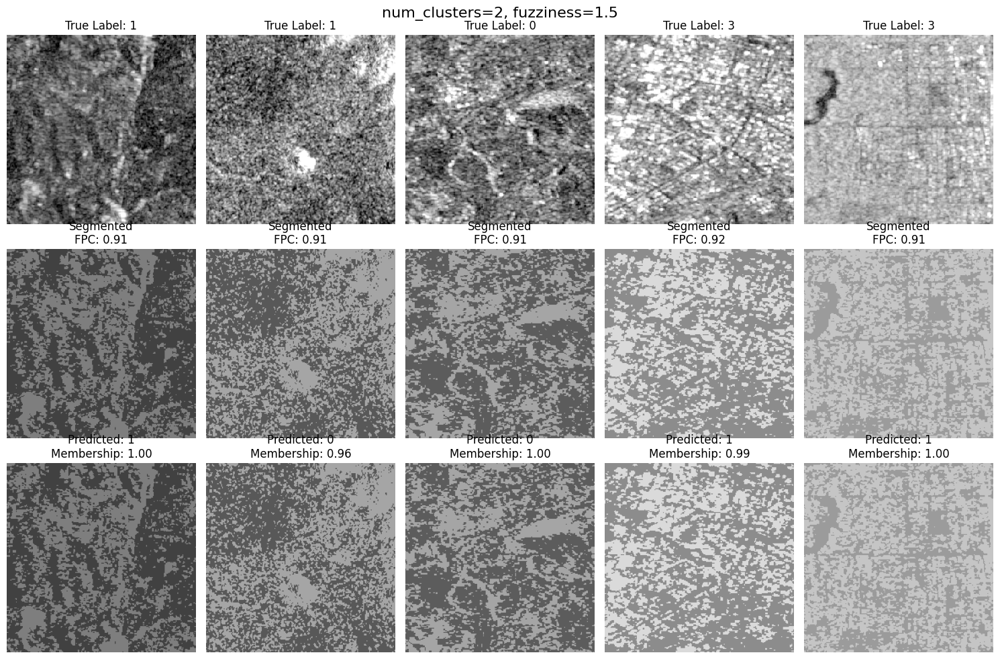


Performing FCM for num_clusters=2 and fuzziness=2...


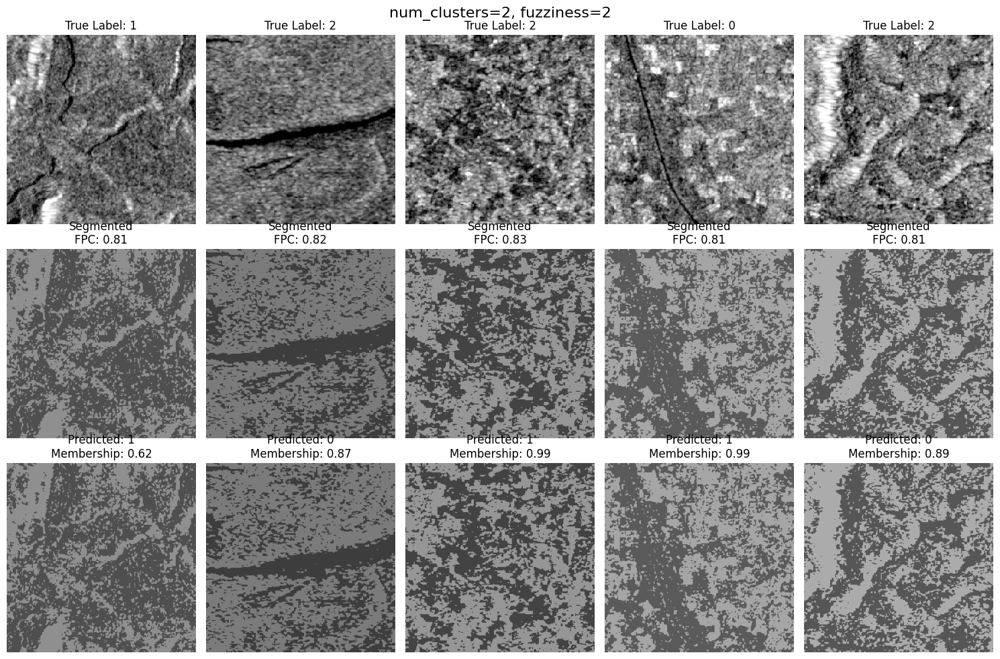


Performing FCM for num_clusters=3 and fuzziness=1.5...


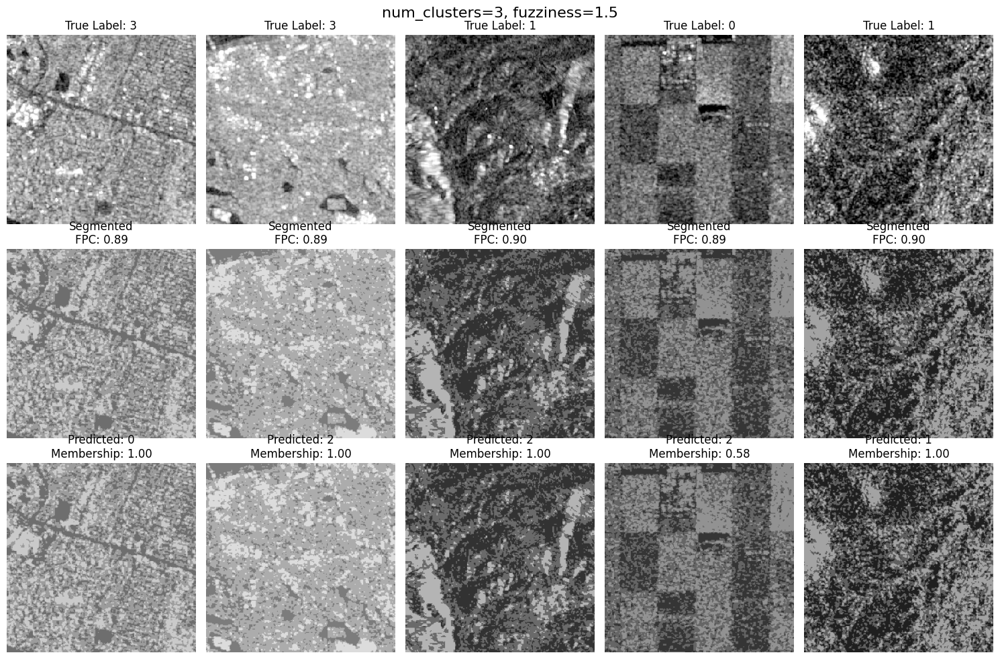


Performing FCM for num_clusters=3 and fuzziness=2...


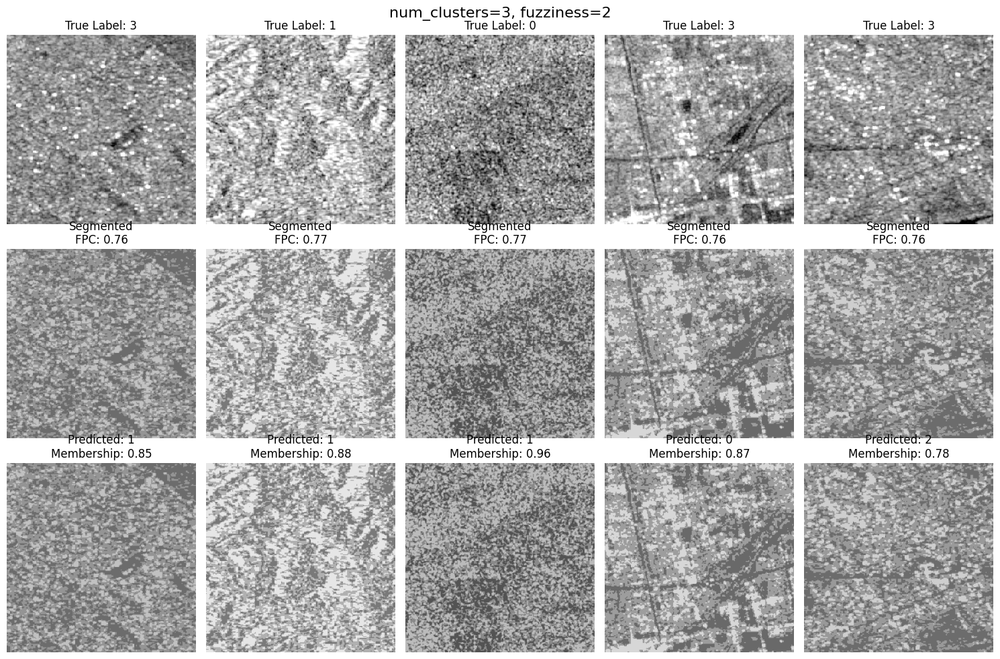


Performing FCM for num_clusters=4 and fuzziness=1.5...


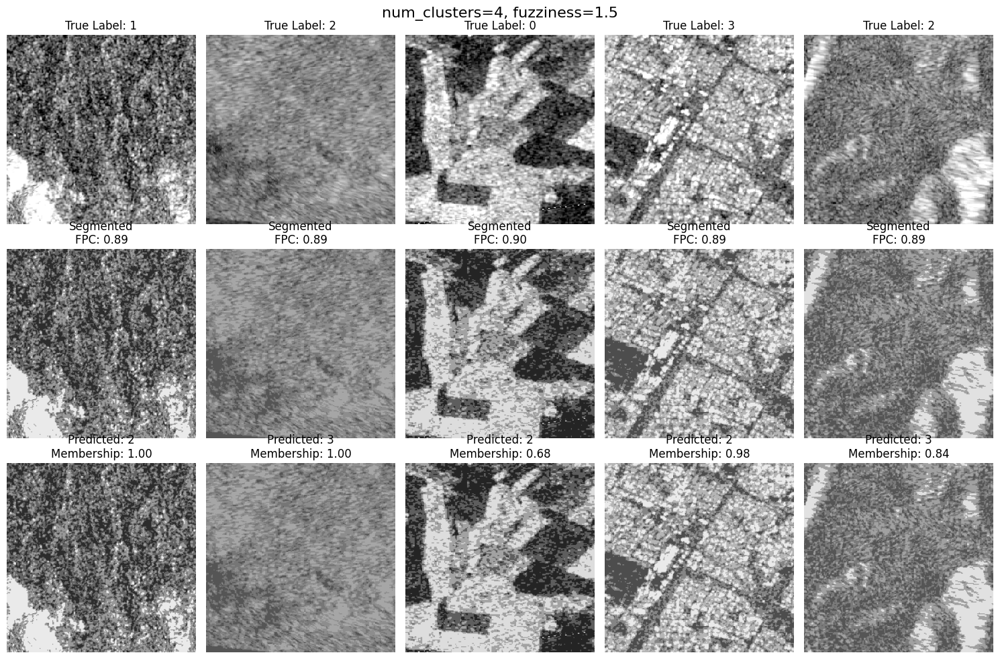


Performing FCM for num_clusters=4 and fuzziness=2...


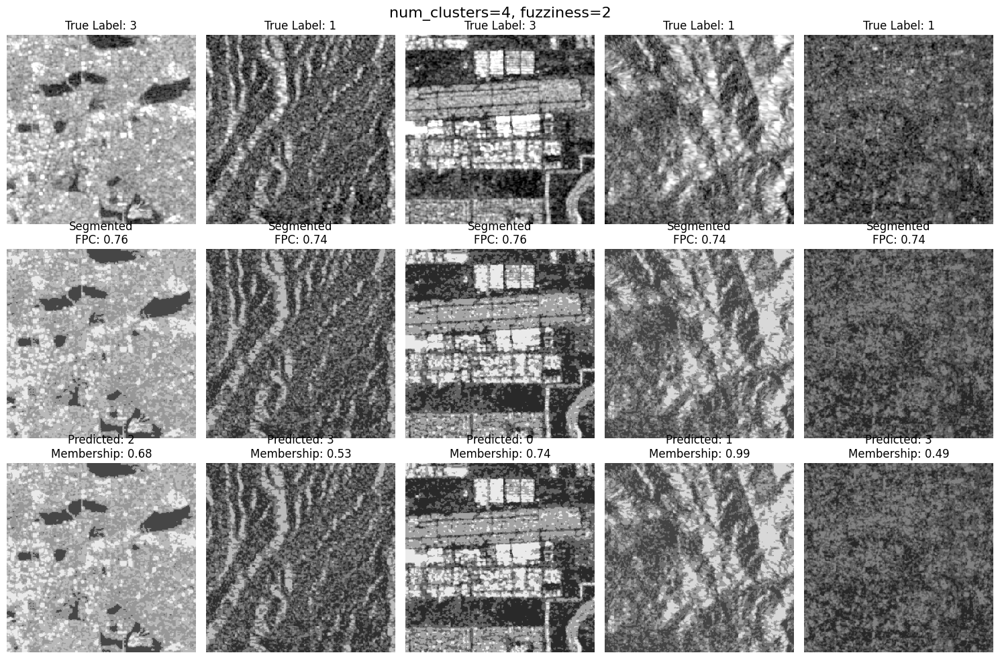


Fuzzy Partition Coefficient (FPC) Results:
num_clusters=2, fuzziness=1.5 -> FPC: 0.9133
num_clusters=2, fuzziness=2 -> FPC: 0.8169
num_clusters=3, fuzziness=1.5 -> FPC: 0.8941
num_clusters=3, fuzziness=2 -> FPC: 0.7640
num_clusters=4, fuzziness=1.5 -> FPC: 0.8906
num_clusters=4, fuzziness=2 -> FPC: 0.7481


In [35]:
import numpy as np
import matplotlib.pyplot as plt
import skfuzzy as fuzz
from itertools import product

# Function to apply Fuzzy C-Means segmentation
def fuzzy_c_means_segmentation(image, num_clusters, fuzziness):
    """Apply Fuzzy C-Means segmentation to a single image."""
    # Reshape the image to a 2D array of pixels
    pixel_values = image.reshape(-1, 3).T  # Shape: (3, num_pixels)

    # Perform Fuzzy C-Means clustering
    cntr, u, _, _, _, _, _ = fuzz.cluster.cmeans(
        pixel_values,
        c=num_clusters,
        m=fuzziness,  # Fuzziness parameter
        error=0.005,
        maxiter=1000,
        init=None
    )

    # Assign each pixel to the cluster with the highest membership value
    cluster_membership = np.argmax(u, axis=0)

    # Create segmented image
    segmented_image = np.zeros_like(pixel_values)
    for i in range(num_clusters):
        segmented_image[:, cluster_membership == i] = cntr[i][:, np.newaxis]

    return segmented_image.T.reshape(image.shape), cluster_membership, u

# Function to calculate Fuzzy Partition Coefficient (FPC)
def calculate_fuzzy_partition_coefficient(u):
    """Calculate the Fuzzy Partition Coefficient (FPC)."""
    return np.sum(u ** 2) / u.shape[1]

# Function to display sample images with segmentation and predicted labels
def segment_and_display_images_grid_search(X_sample, y_sample, num_clusters_list, fuzziness_list):
    """Segment images using different values of num_clusters and fuzziness, and display results."""
    fpc_results = {}
    combinations = list(product(num_clusters_list, fuzziness_list))
    
    for num_clusters, fuzziness in combinations:
        print(f"\nPerforming FCM for num_clusters={num_clusters} and fuzziness={fuzziness}...")

        fpc_values = []
        plt.figure(figsize=(15, 10))

        # Perform segmentation on 5 random images
        indices = np.random.choice(len(X_sample), 5, replace=False)
        
        for i, idx in enumerate(indices):
            original_image = X_sample[idx]
            true_label = np.argmax(y_sample[idx])  # Get true label
            
            # Perform FCM segmentation
            segmented_image, cluster_membership, u = fuzzy_c_means_segmentation(original_image, num_clusters, fuzziness)

            # Calculate FPC for this image
            fpc = calculate_fuzzy_partition_coefficient(u)
            fpc_values.append(fpc)

            # Display original, segmented image, and predicted labels
            plt.subplot(3, 5, i + 1)
            plt.imshow(original_image)
            plt.title(f"True Label: {true_label}")
            plt.axis('off')

            plt.subplot(3, 5, i + 6)
            plt.imshow(segmented_image)
            plt.title(f"Segmented\nFPC: {fpc:.2f}")
            plt.axis('off')

            # Display the predicted labels and membership values
            predicted_label = np.argmax(u, axis=0)
            membership_values = u[predicted_label, np.arange(len(predicted_label))]
            plt.subplot(3, 5, i + 11)
            plt.imshow(segmented_image)
            plt.title(f"Predicted: {predicted_label[0]}\nMembership: {membership_values[0]:.2f}")
            plt.axis('off')

        plt.suptitle(f"num_clusters={num_clusters}, fuzziness={fuzziness}", fontsize=16)
        plt.tight_layout()
        plt.show()

        # Store FPC values for this combination
        fpc_results[(num_clusters, fuzziness)] = np.mean(fpc_values)
    
    return fpc_results

# Example usage:
num_clusters_list = [2, 3, 4]  # Define number of clusters to test
fuzziness_list = [1.5, 2]  # Define fuzziness parameters to test

# Call the function to perform grid search and display segmented images with labels
fpc_results = segment_and_display_images_grid_search(X_sample, y_sample, num_clusters_list, fuzziness_list)

# Output FPC results for each combination
print("\nFuzzy Partition Coefficient (FPC) Results:")
for (num_clusters, fuzziness), fpc in fpc_results.items():
    print(f"num_clusters={num_clusters}, fuzziness={fuzziness} -> FPC: {fpc:.4f}")


In [40]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split
import skfuzzy as fuzz

# Define image size and batch size
IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# 1. Load the dataset and split into train and test sets
# Assuming X and y are already loaded from your data generator

# Split into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Flatten the images (required for Fuzzy C-Means)
X_train_flattened = X_train.reshape(len(X_train), -1)
X_test_flattened = X_test.reshape(len(X_test), -1)

# 2. Train Fuzzy C-Means on Training Data
def train_fuzzy_cmeans(X_train_flattened, num_clusters, fuzziness, max_iter=100, error=0.005):
    """Train Fuzzy C-Means clustering on the training data."""
    cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
        X_train_flattened.T,  # Transpose for cmeans (features, samples)
        c=num_clusters,  # Number of clusters
        m=fuzziness,  # Fuzziness parameter
        error=error,  # Tolerance for stopping criterion
        maxiter=max_iter,  # Maximum iterations
        init=None
    )
    return cntr, u, fpc  # Return cluster centers, membership matrix, and FPC

# 3. Predict using trained Fuzzy C-Means cluster centers
def predict_fuzzy_cmeans(X_test_flattened, cntr, fuzziness, max_iter=100, error=0.005):
    """Predict using Fuzzy C-Means cluster centers on the test data."""
    u_test, u0_test, d_test, jm_test, p_test, fpc_test = fuzz.cluster.cmeans_predict(
        X_test_flattened.T,  # Transpose for cmeans_predict (features, samples)
        cntr,  # Cluster centers from training
        m=fuzziness,  # Fuzziness parameter
        error=error,  # Tolerance for stopping criterion
        maxiter=max_iter  # Maximum iterations
    )
    return u_test  # Return the membership matrix for the test data

# 4. Convert membership matrix to predicted labels
def get_predicted_labels(u):
    """Get predicted labels from membership matrix."""
    return np.argmax(u, axis=0)  # Cluster with highest membership value

# 5. Evaluation: Confusion Matrix and Accuracy
def evaluate_model(y_true, y_pred):
    """Evaluate model performance using confusion matrix and accuracy."""
    conf_matrix = confusion_matrix(y_true, y_pred)
    accuracy = accuracy_score(y_true, y_pred)
    return conf_matrix, accuracy

# Define the number of clusters and fuzziness
num_clusters = len(np.unique(y_train, axis=0))  # Number of clusters equal to number of classes
fuzziness = 2.0  # Fuzziness parameter

# Train the model on the training data
cntr, u_train, fpc_train = train_fuzzy_cmeans(X_train_flattened, num_clusters, fuzziness)

# Predict the membership values for the test data
u_test = predict_fuzzy_cmeans(X_test_flattened, cntr, fuzziness)

# Get predicted labels for the test data
y_pred = get_predicted_labels(u_test)

# Get the true labels by finding the index of the class with the highest value in one-hot encoded format
y_test_labels = np.argmax(y_test, axis=1)

# Evaluate the model
conf_matrix, accuracy = evaluate_model(y_test_labels, y_pred)

# 6. Display the results
print("Confusion Matrix:")
print(conf_matrix)
print(f"\nAccuracy: {accuracy * 100:.2f}%")

# Display 5 sample images with their predicted labels and true labels
def display_predictions(X_test, y_test_labels, y_pred):
    """Display 5 random images with their predicted and true labels."""
    indices = np.random.choice(len(X_test), 5, replace=False)

    plt.figure(figsize=(12, 6))
    for i, idx in enumerate(indices):
        plt.subplot(1, 5, i + 1)
        plt.imshow(X_test[idx])
        plt.title(f"True: {y_test_labels[idx]}\nPred: {y_pred[idx]}")
        plt.axis('off')
    plt.show()

# Display sample predictions
display_predictions(X_test, y_test_labels, y_pred)


KeyboardInterrupt: 